In [100]:
import Pkg; Pkg.activate(@__DIR__); Pkg.instantiate();
using Plots
using LinearAlgebra
using Statistics
using Random
upscale = 1 #8x upscaling in resolution
fntsm = Plots.font("sans-serif", pointsize=round(20.0*upscale))
fntlg = Plots.font("sans-serif", pointsize=round(23.0*upscale))
default(titlefont=fntlg, guidefont=fntlg, tickfont=fntsm, legendfont=fntsm)
# default(colorbar_tickfontsizes = fntlg, colorbar_titlefontsizes = fntsm)
default(size=(800*upscale,600*upscale)) #Plot canvas size
default(dpi=100) #Only for PyPlot - presently broken

  Activating project at `~/Desktop/PHD/Courses/ME597/Project`


┌ Info: Saved animation to /home/mohsafwat/Desktop/PHD/Courses/ME597/Project/vicsek_simulation.gif
└ @ Plots /home/mohsafwat/.julia/packages/Plots/sxUvK/src/animation.jl:156


Plots.AnimatedGif("/home/mohsafwat/Desktop/PHD/Courses/ME597/Project/vicsek_simulation.gif")
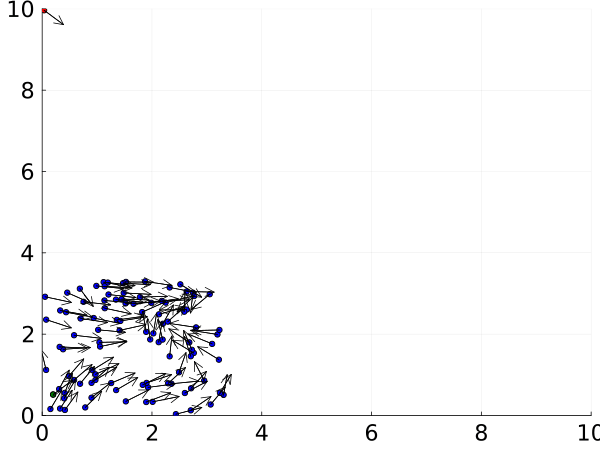

In [96]:
Random.seed!(1)

# Parameters
N = 100  # number of birds
L = 10.0  # area size
eta = 0.1  # noise
v = 0.03  # speed of birds
r = 1.0  # interaction radius
steps = 200  # number of steps
leader_indices = [1]  # indices of leaders 
leader_direction = [1.0, 1.0]  # direction for leaders

positions = rand(N, 2) * L/3
velocities = rand(N, 2) .- 0.5
velocities = velocities ./ sqrt.(sum(velocities .^ 2, dims=2)) .* v


vpred = 0.05  # speed of the predator
predator_pos = [0.0, 10]
predator_vel = [1.0, -1.0]
rpred = 2.0  # avoidance radius for the predator

function update_positions!(positions, velocities, predator_pos)
    global leader_indices, leader_direction
    for i in 1:N
        # find neighbors
        distances = sqrt.(sum((positions .- positions[i, :]') .^ 2, dims=2))
        neighbors = findall(x -> x < r, distances)
        predator_dist = norm(positions[i, :] - predator_pos)
        
        if predator_dist < rpred
            # move away from predator
            direction_away_from_predator = (positions[i, :] - predator_pos) ./ predator_dist
            avg_direction = direction_away_from_predator
        elseif i in leader_indices
            avg_direction = leader_direction
        else
            idx = getindex.(neighbors, 1)
            avg_velocity = mean(velocities[idx, :], dims=1)

            if norm(avg_velocity) > 0
                avg_direction = avg_velocity ./ norm(avg_velocity)
            else
                avg_direction = velocities[i, :]
            end
        end
        
        noise = eta * (rand(2) .- 0.5)                                  
        new_direction = avg_direction #+ noise
        new_direction = new_direction ./ norm(new_direction)
        velocities[i, :] = new_direction .* vpred
    end
    positions .+= velocities
    positions .= mod.(positions, L)

    predator_pos .+= predator_vel ./ norm(predator_vel) .* vpred
    predator_pos .= mod.(predator_pos, L)
end


l = 5.0
anim = @animate for _ in 1:steps
    update_positions!(positions, velocities, predator_pos)
    scatter(positions[:, 1], positions[:, 2], legend=false, xlims=(0, L), ylims=(0, L), marker=:circle, color="blue")
    scatter!([positions[leader_indices, 1]], [positions[leader_indices, 2]], color="green")

    u1 = velocities[:, 1]/norm(velocities)
    u1 = round.(u1, digits=6)
    v1 = velocities[:, 2]/norm(velocities)
    v1 = round.(v1, digits=6)
    # quiver!(positions[:, 1], positions[:, 2], quiver=(2.0*velocities[:, 1], 2.0*velocities[:, 2]), color=:black)
    quiver!(positions[:, 1], positions[:, 2], quiver=(l*u1, l*v1), color=:black)
    scatter!([predator_pos[1]], [predator_pos[2]], color="red")

    u1 = predator_vel[1]/norm(predator_vel)
    u1 = round.(u1, digits=6)
    v1 = predator_vel[2]/norm(predator_vel)
    v1 = round.(v1, digits=6)

    quiver!([predator_pos[1]], [predator_pos[2]], quiver=(l*0.1*[u1], l*0.1*[v1]), color=:black)
end

gif(anim, "vicsek_simulation.gif", fps = 10)

┌ Info: Saved animation to /home/mohsafwat/Desktop/PHD/Courses/ME597/Project/vicsek_simulation_2.gif
└ @ Plots /home/mohsafwat/.julia/packages/Plots/sxUvK/src/animation.jl:156


Plots.AnimatedGif("/home/mohsafwat/Desktop/PHD/Courses/ME597/Project/vicsek_simulation_2.gif")
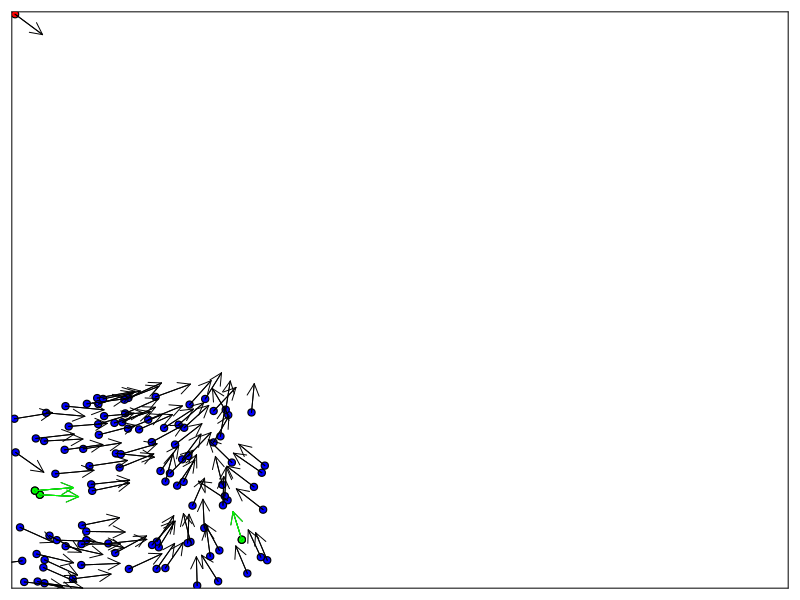

In [106]:
Random.seed!(1)

Tf = 10.0
dt = 0.01
t = Array(range(0, Tf, step=dt))
A = 0.7
leader_direction = [(1 .- A*cos.(t)) (1 .- A*sin.(t))]

steps = length(t)  


N = 100  
L = 10.0 
eta = 0.1 
v = 0.03 
r = 1.5 
leader_indices = [10, 20, 50] 

positions = rand(N, 2) * L/3
velocities = rand(N, 2) .- 0.5
velocities = velocities ./ sqrt.(sum(velocities .^ 2, dims=2)) .* v


vpred = 0.06  
predator_pos = [0.0, 10]
predator_vel = [1.0, -1.0]
rpred = 1.5  

function update_positions!(k, positions, velocities, predator_pos)
    global leader_indices, leader_direction
    for i in 1:N
        distances = sqrt.(sum((positions .- positions[i, :]') .^ 2, dims=2))
        neighbors = findall(x -> x < r, distances)
        predator_dist = norm(positions[i, :] - predator_pos)
        
        if predator_dist < rpred
            direction_away_from_predator = (positions[i, :] - predator_pos) ./ predator_dist
            avg_direction_away = direction_away_from_predator
        else
            avg_direction_away = [0.,0]
        end


        # else
        idx = getindex.(neighbors, 1)
        avg_velocity = mean(velocities[idx, :], dims=1)

        if norm(avg_velocity) > 0
            avg_direction = avg_velocity ./ norm(avg_velocity)
        else
            avg_direction = velocities[i, :]
        end
        # @show size(avg_velocity)
        avg_direction = avg_direction'[:]

        if i in leader_indices
            avg_direction += 0.3*(leader_direction[k,:]-avg_direction)
            # avg_direction = leader_direction[k,:]
        end
        # end

        # @show size(avg_direction_away)
        # @show size(avg_direction)
        α = 4.0
        β = 1.5
        # β = 0.0
        
        noise = eta * (rand(2) .- 0.5)                                  # Can add optional noise
        new_direction = α*avg_direction + β*avg_direction_away#+ noise
        new_direction = new_direction ./ norm(new_direction)
        velocities[i, :] = new_direction .* v
    end
    positions .+= velocities
    positions .= mod.(positions, L)

    predator_pos .+= predator_vel ./ norm(predator_vel) .* vpred
    predator_pos .= mod.(predator_pos, L)
end

l = 5.0
anim = @animate for k in 1:steps
    update_positions!(k, positions, velocities, predator_pos)

    distances = sqrt.(sum((positions .- predator_pos') .^ 2, dims=2))
    near_pred = findall(x -> x < r, distances)
    idx = getindex.(near_pred, 1)
    scatter(positions[idx, 1], positions[idx, 2], legend=false, 
        xlims=(0, L), ylims=(0, L), marker=:circle, color="red",
        ticks = false, framestyle = :box)
    not_near_pred = setdiff(1:N, idx)
    scatter!(positions[not_near_pred, 1], positions[not_near_pred, 2], marker=:circle, color="blue")
    scatter!([positions[leader_indices, 1]], [positions[leader_indices, 2]], color="lime")

    u1 = velocities[:, 1]/norm(velocities)
    u1 = round.(u1, digits=6)
    v1 = velocities[:, 2]/norm(velocities)
    v1 = round.(v1, digits=6)
    quiver!(positions[:, 1], positions[:, 2], quiver=(l*u1, l*v1), color=:black)

    u1 = velocities[leader_indices, 1]/norm(velocities)
    u1 = round.(u1, digits=6)
    v1 = velocities[leader_indices, 2]/norm(velocities)
    v1 = round.(v1, digits=6)
    quiver!(positions[leader_indices, 1], positions[leader_indices, 2], quiver=(l*u1, l*v1), color=:lime)


    scatter!([predator_pos[1]], [predator_pos[2]], color="red")
    u1 = predator_vel[1]/norm(predator_vel)
    u1 = round.(u1, digits=6)
    v1 = predator_vel[2]/norm(predator_vel)
    v1 = round.(v1, digits=6)

    quiver!([predator_pos[1]], [predator_pos[2]], quiver=(l*0.1*[u1], l*0.1*[v1]), color=:black)
end

gif(anim, "vicsek_simulation_2.gif", fps = 10)